In [1]:
import pandas as pd

In [2]:
x = pd.read_csv("gnn_input.csv")
x.head()

,Unnamed: 0,key,severityavg_severity,severitymax_severity,severitynum_barriers,lengthfirst,CurbRamp_count,NoCurbRamp_count,NoSidewalk_count,Obstacle_count,...,NoCurbRamp_max,NoSidewalk_max,Obstacle_max,Occlusion_max,Other_max,SurfaceProblem_max,u_lat,u_lon,v_lat,v_lon
0,0,0.0,1.0,1.0,1,317.313855,1,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,47.662018,-122.322863,47.664871,-122.322864
1,1,0.0,1.0,1.0,2,19.772566,2,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,47.648425,-122.342633,47.648600,-122.342604
2,2,0.0,2.0,3.0,2,13.534974,2,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,47.646925,-122.336374,47.646803,-122.336373
3,3,0.0,1.0,1.0,2,16.156787,2,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,47.646921,-122.334031,47.647067,-122.334030
4,4,0.0,3.0,3.0,1,11.729261,1,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,47.665809,-122.301937,47.665880,-122.302052


In [11]:
x.columns

Index(['Unnamed: 0', 'key', 'severityavg_severity', 'severitymax_severity',
       'severitynum_barriers', 'lengthfirst', 'CurbRamp_count',
       'NoCurbRamp_count', 'NoSidewalk_count', 'Obstacle_count',
       'Occlusion_count', 'Other_count', 'SurfaceProblem_count',
       'CurbRamp_avg', 'NoCurbRamp_avg', 'NoSidewalk_avg', 'Obstacle_avg',
       'Occlusion_avg', 'Other_avg', 'SurfaceProblem_avg', 'CurbRamp_max',
       'NoCurbRamp_max', 'NoSidewalk_max', 'Obstacle_max', 'Occlusion_max',
       'Other_max', 'SurfaceProblem_max', 'u_lat', 'u_lon', 'v_lat', 'v_lon'],
      dtype='object')

In [8]:
df=x.copy()

In [13]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from shapely.geometry import Point


G = nx.Graph()

# helper to avoid float precision mismatch
def node_key(lat, lon):
    return (round(lat, 6), round(lon, 6))

for _, r in df.iterrows():

    u = node_key(r["u_lat"], r["u_lon"])
    v = node_key(r["v_lat"], r["v_lon"])

    # Add nodes with position (lon,lat for plotting)
    G.add_node(u, pos=(u[1], u[0]))
    G.add_node(v, pos=(v[1], v[0]))

    # ---- EDGE FEATURES FROM YOUR DATASET ----
    G.add_edge(u, v, **{
        "length": r["lengthfirst"],
        "num_barriers": r["severitynum_barriers"],
        "avg_severity": r["severityavg_severity"],

        "CurbRamp": r["CurbRamp_count"],
        "NoCurbRamp": r["NoCurbRamp_count"],
        "NoSidewalk": r["NoSidewalk_count"],
        "Obstacle": r["Obstacle_count"],
        "Occlusion": r["Occlusion_count"],
        "Other": r["Other_count"],
        "SurfaceProblem": r["SurfaceProblem_count"],

        # max values (useful later for risk)
        "NoCurbRamp_max": r["NoCurbRamp_max"],
        "SurfaceProblem_max": r["SurfaceProblem_max"]
    })

print("Nodes:", G.number_of_nodes())
print("Edges:", G.number_of_edges())

Nodes: 43106
Edges: 36689


In [6]:
# !pip install shapely

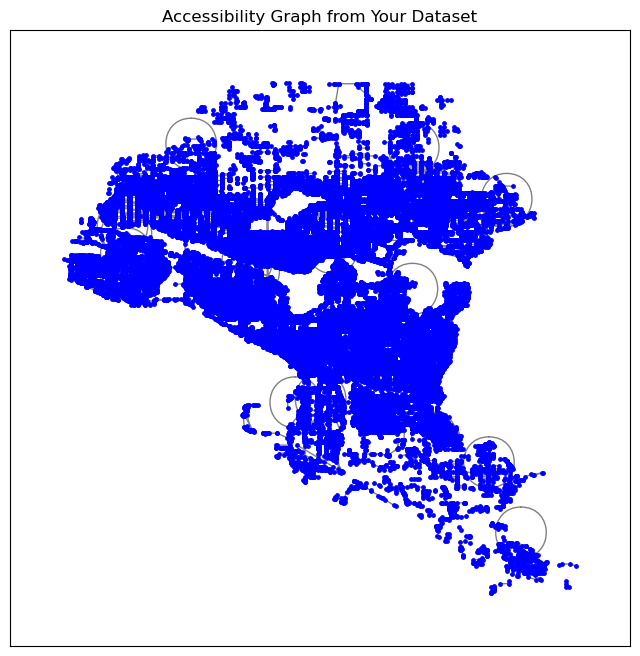

In [15]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(8, 8))

pos = nx.get_node_attributes(G, "pos")

nx.draw_networkx(
    G,
    pos=pos,
    ax=ax,
    node_size=6,
    edge_color="gray",
    node_color="blue",
    width=1,
    with_labels=False
)

ax.set_title("Accessibility Graph from Your Dataset")
plt.show()


In [17]:
plt.savefig("my_plot.png", dpi=300)

<Figure size 640x480 with 0 Axes>

In [20]:
import folium
import networkx as nx

# Center of your data (average lat/lon)
lats = [n[0] for n in G.nodes()]
lons = [n[1] for n in G.nodes()]

m = folium.Map(
    location=[sum(lats)/len(lats), sum(lons)/len(lons)],
    zoom_start=13,
    tiles="cartodbpositron"
)

# Draw each edge on map
for u, v, data in G.edges(data=True):

    folium.PolyLine(
        locations=[ [u[0], u[1]], [v[0], v[1]] ],
        color="blue",
        weight=2,
        opacity=0.7,
        tooltip=f"barriers: {data['num_barriers']}"
    ).add_to(m)

m

In [21]:
# !pip install folium